In [1]:
from default_import import *
from dat_analysis.plotting.plotly.plotly_util import make_slider_figure


importing


# Conductance Vs Temperature Measurements
Idea is to take 2D conductance plots at various temperatures, and then see if the temperature dependece between them identifies any Kondo regimes

## Aug 16th 2022
Measurements taken last night with Nose gate on one axis and Right coupling gate on the other. Taken with 3 different values of Plunger gate (-300, -400, -500). With two different DC biases (~10uV and ~100uV). Repeated at several temperatures between 300 mK to base T.
Dats259 -> ??? 

Results in 6 measurements per temperature

|  Temperature /mK| Plunger /mV |          |          |
|-----------------|-------------|----------|----------|
|                 | -300        | -400     | -500     |
|-----------------|-------------|----------|----------|
| 300             | 259, 260    | 261, 262 | 263, 264 |
| 250             | 265, 266    | ..       | ..       |
| 200             | 271, 272    | ..       | ..       |
| 150             | 277, ..     | ..       | ..       |
| 100             | 283, ..     | ..       | ..       |
| 75              | 289, ..     | ..       | ..       |
| 50              | 295, ..     | ..       | ..       |
| 30              | 301, ..     | ..       | ..       |
| base T          | 307, ..     | ..       | ..       |

First dat is ~10uV, second is ~100uV for each cell

In [4]:
all_dats = list(range(259, 310+1))   # Still running
# for num in all_dats:
#     dat = get_dat(num)
#     print(f'Dat{dat.datnum}: {dat.Logs.temperatures.mc*1000:.0f}mK, {dat.Logs.dacs["P1a"]:.0f}')

dat_temp_sets = [all_dats[i::6] for i in range(6)]

In [5]:
for temp_set in dat_temp_sets:
    dats = [get_dat(num) for num in temp_set]
    datas = [dat.Data.get_data('current_2d') for dat in dats]
    xs = [dat.Data.x for dat in dats]
    ys = [dat.Data.y for dat in dats]
    ids = [U.sig_fig(dat.Logs.temperatures.mc*1000, sf=3) for dat in dats]
    titles = [f'Dat{dat.datnum}, Temperature = {dat.Logs.temperatures.mc*1000:.0f} mK, P1a/P1b = {dat.Logs.dacs["P1a"]:.0f} mV, CAbias*100 = {dat.Logs.dacs["CA1bias*100"]:.1f} mV' for dat in dats]
    labels = None
    xlabel = dats[0].Logs.x_label
    ylabel = dats[0].Logs.y_label
    plot_kwargs = None
    
    fig = make_slider_figure(datas, xs, ys, ids, titles, labels, xlabel, ylabel, plot_kwargs)
    fig.update_layout(height=700)
    
    # fig.show(config=default_config)
    fig.write_html(
        os.path.join(fig_dir, f'Dats{dats[0].datnum}-{dats[-1].datnum}--Plungers[{dats[0].Logs.dacs["P1a"]:.0f}mV]-CABias[{dats[0].Logs.dacs["CA1bias*100"]:.1f}].html')
    )


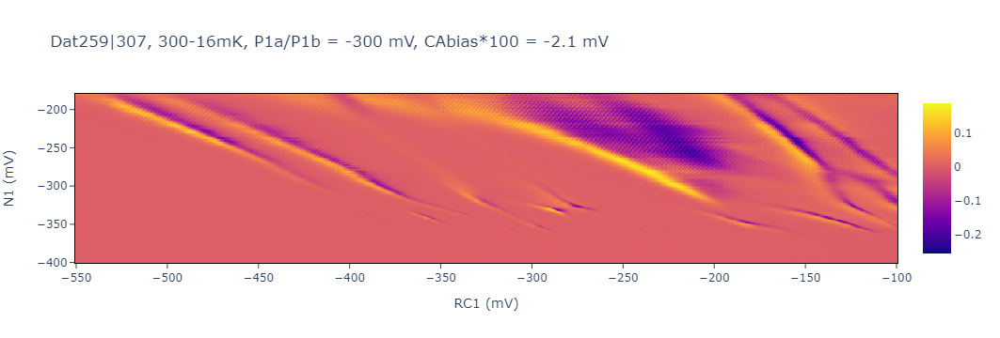

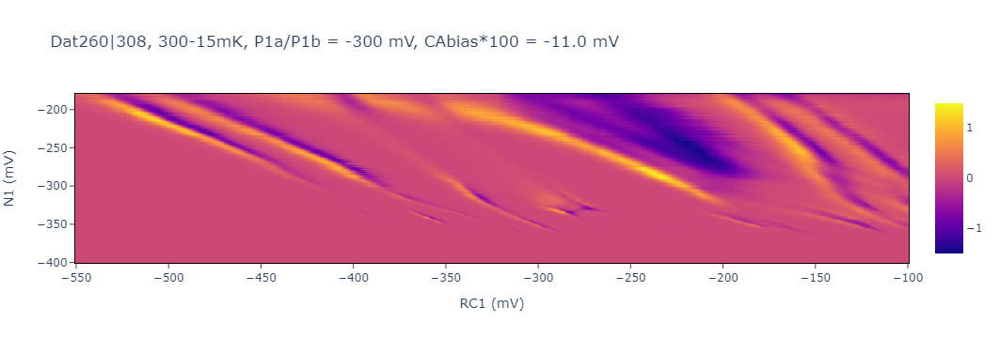

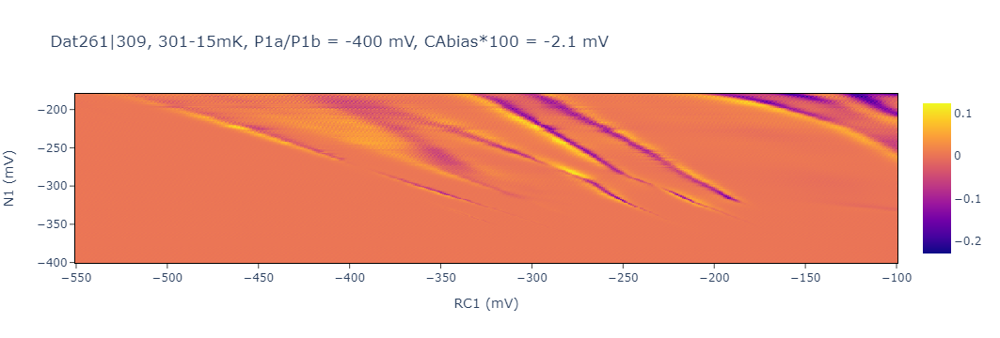

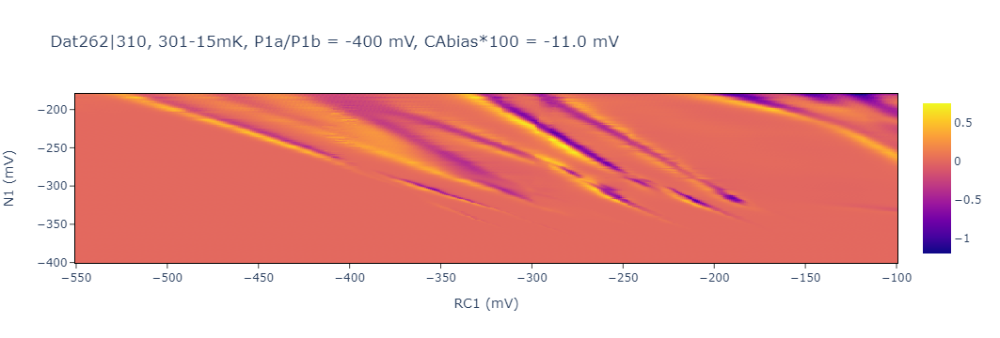

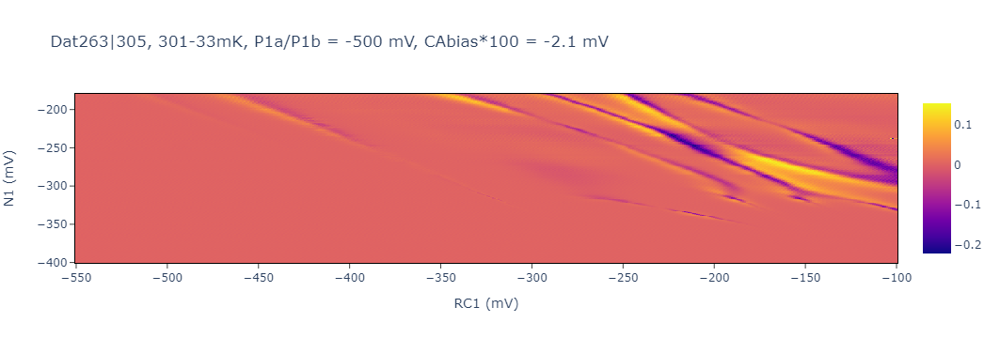

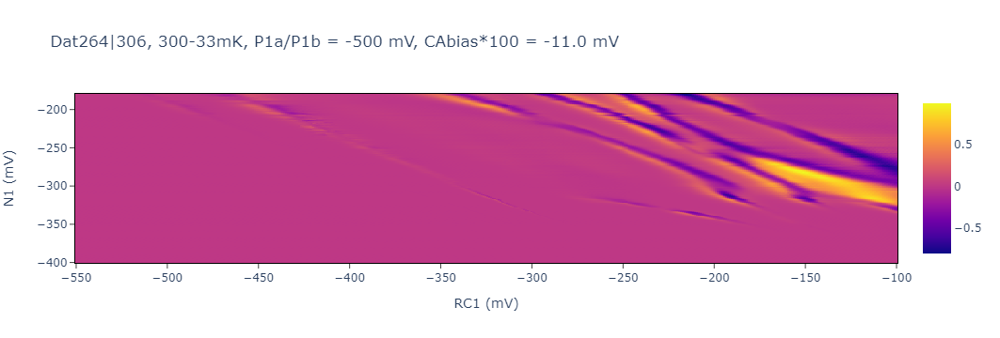

In [6]:
for temp_set in dat_temp_sets:
    hot_dat = get_dat(temp_set[0])
    cold_dat = get_dat(temp_set[-1])
    
    x = hot_dat.Data.x
    y = hot_dat.Data.y
    difference = hot_dat.Data.get_data('current_2d') - cold_dat.Data.get_data('current_2d')
    title = f'Dat{hot_dat.datnum}|{cold_dat.datnum}, {hot_dat.Logs.temperatures.mc*1000:.0f}-{cold_dat.Logs.temperatures.mc*1000:.0f}mK, P1a/P1b = {hot_dat.Logs.dacs["P1a"]:.0f} mV, CAbias*100 = {hot_dat.Logs.dacs["CA1bias*100"]:.1f} mV'
    xlabel = hot_dat.Logs.x_label
    ylabel = hot_dat.Logs.y_label
    
    difference, x = U.resample_data(difference, x=x, resample_x_only=True, max_num_pnts=501)
    
    fig = default_fig()
    fig.update_layout(
        title=title,
        xaxis_title=xlabel,
        yaxis_title=ylabel,
    )
    fig.add_trace(go.Heatmap(x=x, y=y, z=difference))
    
    fig.show(config=default_config)
    

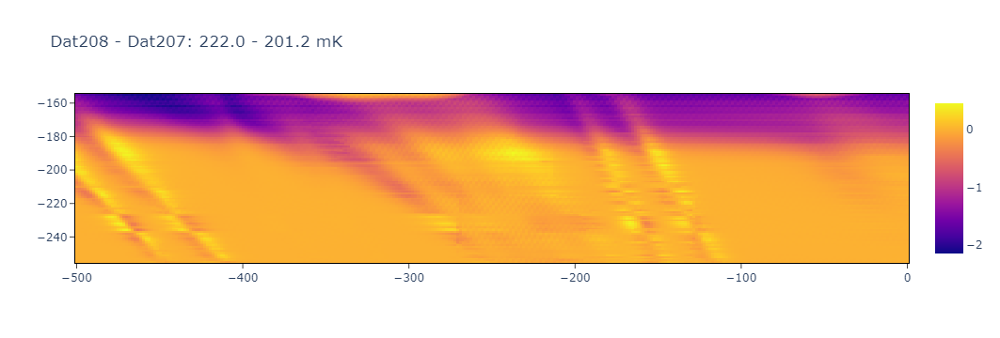

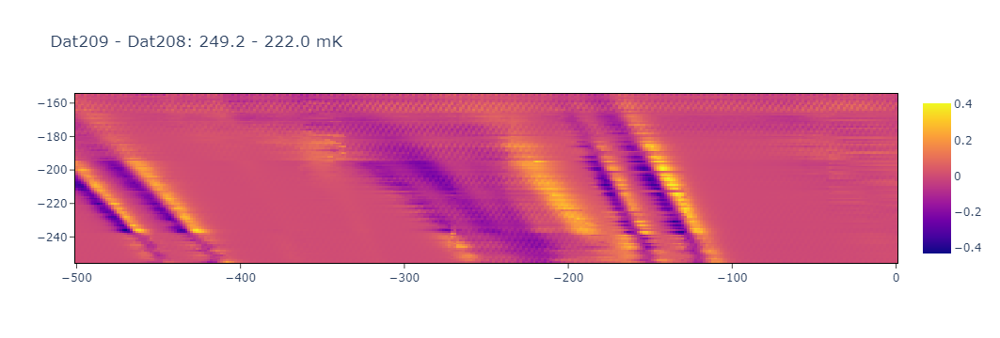

In [7]:
datnums = [207, 208, 209]

dats = [get_dat(num) for num in datnums]
x = dats[0].Data.x
y = dats[0].Data.y

datas = np.array([dat.Data.get_data('current_2d') for dat in dats])

diff = np.diff(datas, axis=0)
titles = []
for i in range(len(dats)-1):
    dat1 = dats[i+1]
    dat2 = dats[i]
    t1 = dat1.Logs.temperatures.mc*1000
    t2 = dat2.Logs.temperatures.mc*1000
    titles.append(f'Dat{dat1.datnum} - Dat{dat2.datnum}: {t1:.1f} - {t2:.1f} mK')

for z, title in zip(diff, titles):
    fig = go.Figure()
    fig.update_layout(**default_layout,
                     title=title)
    fig.add_trace(go.Heatmap(x=x, y=y, z=z))
    fig.show(config=default_config)



If peaks go dark->bright or bright->dark in a single transition, then it is just a sign of the transitions shifting slightly left or right between scans.

If the peaks alternate brighter/darker, that may be a sign of Kondo effect (i.e. Kondo peaks only in the odd valleys)